Universidad Galileo

Statistical Learning 2

PAPD - Sección V

Sergio José Barrios Martínez

Carnet No. 19012765

# Proyecto Final Curso

## Parte No. 2:
## Transfer Style con Transfer Learning en Red Neuronal Convolucional

Para esta parte del proyecto se propuso trabajar sobre el paper de "Style Transfer", utilizando redes convolucionales y "Transfer Learning" utilizando un modelo VGG de 19 capas pre-entrenado sobre el dataset "ImageNet".


In [4]:
import numpy as np
from IPython.display import Image, display
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.applications import vgg19
import matplotlib.pyplot as plt
import pickle

### Lectura de Imágenes
Se carga una imagen a transformar y una imagen de la cual se intentará la transferencia de estilo. 

In [5]:
path_imagen_contenido = ".\\fuentes\\Mama.jpg"
path_imagen_estilo = ".\\fuentes\\VanGogh.jpg"

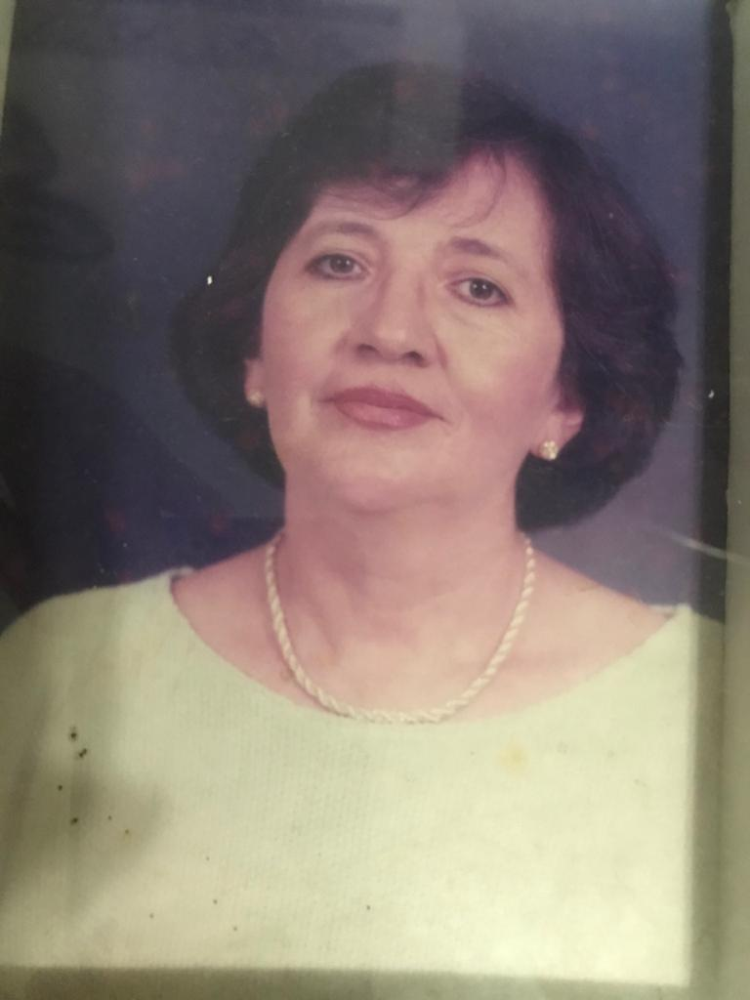

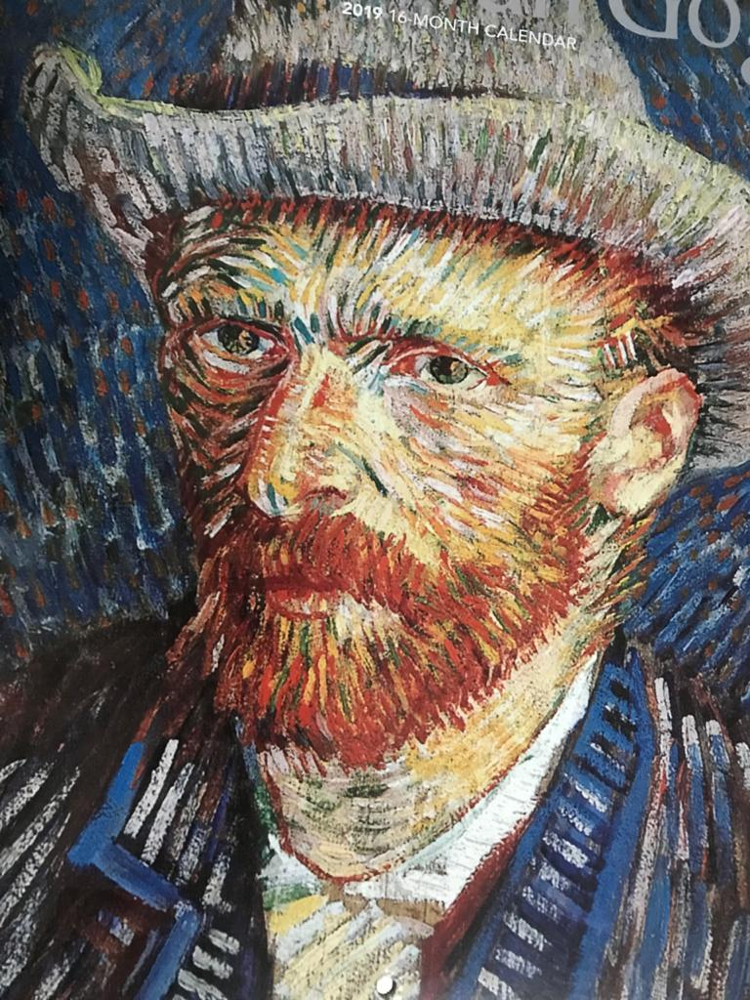

In [6]:
display(Image(path_imagen_contenido,width = 400, height = 200))
display(Image(path_imagen_estilo,width = 400, height = 200))

### Escalamiento de Imágenes
Posterior a cargar las imágenes, es necesario conocer su tamaño. Esto se realiza con el propósito de estandarizar su tamaño a uno más reducido, ya que tamaños muy grandes enlentecen el procesamiento posterior. En este caso, se especifica el número de filas como parámetro independiente, y el parámetro de columnas vendrá dado por el cálculo de proporción (esto para mantener la relación ancho-altura en la imagen final).

In [7]:
# Dimensiones de la imagen fuente
ancho, alto = keras.preprocessing.image.load_img(path_imagen_contenido).size
filas_imagen = 400
columnas_imagen = int(ancho * filas_imagen / alto)

### Función de Conversión de Imágenes a Tensores

Las imagenes deben ser convertidas a tensores, con el objetivo de que puedan ejecutarse las funciones de costo y el entrenamiento. Este pre-procesamiento consiste en lo siguiente:
- Re-escalamiento de la imagen a valores reducidos, de acuerdo al parámetro de filas especificado (el número de columnas se calcula con el objetivo de mantener las proporciones de la imagen).
- Conversión de la imagen a un arreglo.
- Función de pre-procesamiento del modelo VGG19.
- Conversión a Tensor con la función tf.convert_to_tensor.

In [8]:
def imagen_a_tensor(ruta,filas,columnas):
    imagen = keras.preprocessing.image.load_img(ruta, target_size=(filas, columnas)) # Reshape de la Imagen
    arreglo = np.expand_dims(keras.preprocessing.image.img_to_array(imagen),axis=0)# Conversión de Imagen a Arreglo
    arreglo_procesado = vgg19.preprocess_input(arreglo) # Pre-procesamiento del modelo VGG19
    tensor = tf.convert_to_tensor(arreglo_procesado) # Tensor Procesado
    return tensor

### Función de Conversión de Tensores a Imágenes

Los tensores procesados del modelo deben convertirse nuevamente a imágenes, con el objetivo de poder ver el avance del entrenamiento y finalmente el resultado final.
- Reshape del tensor de acuerdo al parámetro de filas y columnas especificado.
- Normalización de pixeles.
- Conversión de BGR a RGB.
- Limitación de valores al rango [0-255] correspondientes al rango válido de intensidad de pixel.

In [9]:
def tensor_a_imagen(tensor,filas,columnas):
    
    # Reshape del tensor a una matriz con filas y columnas de la imagen
    tensor = tensor.reshape((filas, columnas, 3))
    
    # Se remueve el centrado en cero
    tensor[:, :, 0] += 103.939
    tensor[:, :, 1] += 116.779
    tensor[:, :, 2] += 123.68
    
    # Conversión de 'BGR' a 'RGB'
    tensor = tensor[:, :, ::-1]
    
    # Limitación de valores al rango [0-255]
    imagen = np.clip(tensor, 0, 255).astype("uint8")
    return imagen

### Cálculo de la Matriz de Gram del Tensor
La matriz Gram del tensor se obtiene haciendo la multiplicación (producto interno) del tensor en forma plana con el mismo tensor en forma transpuesta.
Para ello es necesario primero hacer reshape del tensor para aplanar las dimensiones.

In [10]:
def matriz_gram(tensor):
    tensor = tf.transpose(tensor, (2, 0, 1))
    features = tf.reshape(tensor, (tf.shape(tensor)[0], -1))
    matriz_gram = tf.matmul(features, tf.transpose(features))
    return matriz_gram

### Funciones de Costo
En esta aplicación particular, se trabajará con tres funciones de costo:
- **Función de Costo de Contenido**: Mide una *diferencia de contenido* entre la imagen objetivo y la imagen base. Esta es una parte de la función de costo a minimizar, pues se intenta que la diferencia de contenido entre la imagen base y la imagen objetivo sea mínima.
- **Función de Costo de Estilo**: Mide una *diferencia de estilo*. Esta es la diferencia entre los features extraídos en la matriz gram de la imagen con el estilo y los features extraídos en la matriz gram de la imagen objetivo. Esta es una función de costo a minimizar, pues se intenta que la diferencia entre el estilo de la imagen generada y la imagen con el estilo sea mínima.
- **Función de Costo Total**: Esta función de costo suma los costos anteriores y se combinan con pesos especificados.

In [11]:
def funcion_costo_contenido(base, objetivo):
    return tf.reduce_sum(tf.square(objetivo - base))

In [12]:
def funcion_costo_estilo(estilo, objetivo,filas,columnas):
    features_estilo = matriz_gram(estilo)
    features_objetivo = matriz_gram(objetivo)
    numero_canales = 3
    tamaño = filas * columnas
    return tf.reduce_sum(tf.square(features_estilo - features_objetivo)) / (4.0 * (numero_canales ** 2) * (tamaño ** 2))

### Modelo VGG19
Se selecciona una arquitectura VGG19, con pesos entrenados sobre el dataset **ImageNet** (sin incuir la capa de entrada).

In [13]:
# Modelo VGG19 con Parámetros Entrenados sobre Dataset "ImageNet"
VGG19_imagenet = vgg19.VGG19(weights="imagenet", include_top=False)

### Modelo Secundario Auxiliar para Visualización
Como se comentó en clase, se utilizará un segundo modelo con el objetivo de poder almacenar los valores de activación resultantes del modelo principal. Este modelo no se entrenará, sino que servirá para visualizar el proceso de entrenamiento.

In [14]:
# Diccionario con Nombres de las Capas del Modelo VGG19
diccionario_capas = dict([(layer.name, layer.output) for layer in VGG19_imagenet.layers])

# Se utiliza un modelo secundario (que no se entrenará) para almacenar los valores de activación para cada capa del modelo VGG19
valores_activacion = keras.Model(inputs=VGG19_imagenet.inputs, outputs=diccionario_capas)

### Cálculo de Costo y Pesos
En esta parte se definen los parámetros de pesos para poder ponderar el estilo y el contenido de la imagen objetivo.
Puede experimentarse con distintos valores

In [15]:
# Pesos para la función de Pérdida (Loss Function)
ponderacion_estilo = 1e-6
ponderacion_contenido = 2.5e-8

### Lista de Capas a utilizar del Modelo VGG19
Siguiendo la recomendación del paper "Style Transfer" se toman las siguientes capas convolucionales del modelo VGG19

In [16]:
# Lista de Capas para el Costo de Estilo
nombres_capas_estilo = [
    "block1_conv1",
    "block2_conv1",
    "block3_conv1",
    "block4_conv1",
    "block5_conv1",
]
# Lista de Capas para el Costo de Contenido
nombre_capa_contenido = "block5_conv2"

### Función de Costo
La función de costo está formada por la diferencia ponderada entre la imagen objetivo y la imagen con el contenido (imagen base) y la diferencia ponderada entre la imagen objetivo y la imagen con el estilo. Esta suma ponderada es la que se trata de minimizar, por lo que el contenido y el estilo tienen una función de costo que finalmente se suma en una función de costo total.

In [17]:
def funcion_costo(imagen_objetivo, imagen_contenido, imagen_estilo,filas_imagen,columnas_imagen):
    
    # Tensor de Entrada (Posición 0: imagen de contenido, Posición 1: imagen de estilo, Posición 2: imagen objetivo)
    tensor_entrada = tf.concat( [imagen_contenido, imagen_estilo, imagen_objetivo], axis=0 )
    features = valores_activacion(tensor_entrada)
    costo = tf.zeros(shape=())

    # Costo de Contenido 
    # Ponderación de Diferencia de Contenido entre Imagen Base e Imagen Objetivo
    features_capa = features[nombre_capa_contenido] # Dado que sólo es una capa, se extrae directamente el contenido
    features_imagen_contenido = features_capa[0, :, :, :] # Posicion 0: imagen de contenido
    features_imagen_objetivo = features_capa[2, :, :, :] # Posicion 2: imagen objetivo
    costo += ponderacion_contenido * funcion_costo_contenido(features_imagen_contenido, features_imagen_objetivo)
     
    # Costo de Estilo 
    # Ponderación de Diferencia de Estilo entre Imagen Estilo e Imagen Objetivo
    for capa in nombres_capas_estilo: # Dado que son 5 capas de Features de Estilo, se recorre cada una
        features_capa = features[capa]
        features_imagen_estilo = features_capa[1, :, :, :] # Posicion 1: imagen de estilo
        features_imagen_objetivo = features_capa[2, :, :, :] # Posicion 2: imagen objetivo
        costo_estilo = funcion_costo_estilo(features_imagen_estilo, features_imagen_objetivo,filas_imagen,columnas_imagen)
        costo += (ponderacion_estilo / len(nombres_capas_estilo)) * costo_estilo
   
    return costo


### Cálculo de Gradientes

In [18]:
@tf.function
def calculo_Gradientes(tensor_imagen_objetivo, tensor_imagen_contenido, tensor_imagen_estilo,filas_imagen,columnas_imagen):
    with tf.GradientTape() as tape:
        costo = funcion_costo(tensor_imagen_objetivo, tensor_imagen_contenido, tensor_imagen_estilo,filas_imagen,columnas_imagen)
    gradientes = tape.gradient(costo, tensor_imagen_objetivo)
    return costo, gradientes

### Función de Visualización de Representaciones Intermedias
Para poder observar las representaciones intermedias devueltas por los filtros en las capas de estilo sobre la imagen objetivo, se define una función que guardará estos tensores. Esta función será llamada cada cierto número de iteraciones, para poder observar su progreso.

In [19]:
def visualizacion_intermedias(imagen_objetivo,imagen_contenido,imagen_estilo):
    
    # Tensor de Entrada (Posición 0: imagen de contenido, Posición 1: imagen de estilo, Posición 2: imagen objetivo)
    tensor_entrada = tf.concat( [imagen_contenido, imagen_estilo, imagen_objetivo], axis=0 )
    features = valores_activacion(tensor_entrada)
    
    intermedias = []
     
    # Extracción de Características Intermedias
    for capa in nombres_capas_estilo: # Dado que son 5 capas de Features de Estilo, se recorre cada una
        features_capa = features[capa]
        features_imagen_objetivo = features_capa[2, :, :, :] # Posicion 2: imagen objetivo
        intermedias.append(features_imagen_objetivo)

    return intermedias
     

### Optimizador
En esta sección se hizo experimentación con SGD, y una tasa de aprendizaje decreciente, especificando los steps de decaimiento y la tasa de decaimiento entre steps (ver logs de Tensorboard en el repositorio)

In [26]:
lr_inicio = 100.0
steps_decaimiento = 100
tasa_decaimiento = 0.96

optimizador = keras.optimizers.SGD(
    keras.optimizers.schedules.ExponentialDecay(initial_learning_rate=lr_inicio, decay_steps=steps_decaimiento, decay_rate=tasa_decaimiento)
)

### TensorBoard
Se lleva una bitácora de experimentación utilizando TensorBoard. En este caso, se trata únicamente de minimizar el costo total. Se crea un string de configuración para guardar la historia en TensorBoard que identifica Learning Rate, Steps de Decaimiento y Tasa de Decaimiento del Learning Rate.

In [27]:
train_log_dir = 'logs/lr=' + str(lr_inicio) + '_dsteps='+str(steps_decaimiento)+'_drate='+str(tasa_decaimiento)
train_summary_writer = tf.summary.create_file_writer(train_log_dir)

### Entrenamiento Transferencia de Estilo, Checkpoints y Deployment
Finalmente se realiza el entrenamiento. Se realiza el mismo con TensorFlow-GPU, con una GPU **Nvidia GeForce RTX 2060**.

En este caso particular, se hace experimentación con el número de iteraciones y se busca minimizar el costo total. Los primeros experimentos se realizaron para 1000 iteraciones, para encontrar un valor óptimo de hiper-parámetros. Al encontrar estos valores, se aumenta el número de iteraciones a 4000 con el objetivo de mejorar el resultado final.

Para los **checkpoints**, se guarda cada 100 iteraciones el modelo entrenado a disco (puede verse el record de almacenamiento en el repositorio). 

In [28]:
tensor_imagen_contenido = imagen_a_tensor(path_imagen_contenido,filas_imagen,columnas_imagen)
tensor_imagen_estilo = imagen_a_tensor(path_imagen_estilo,filas_imagen,columnas_imagen)
tensor_imagen_objetivo = tf.Variable(imagen_a_tensor(path_imagen_contenido,filas_imagen,columnas_imagen))

iteraciones = 4000

representaciones = []

for iteracion in range(1, iteraciones + 1):
    costo, gradientes = calculo_Gradientes(tensor_imagen_objetivo, tensor_imagen_contenido, tensor_imagen_estilo,filas_imagen,columnas_imagen)
    
    optimizador.apply_gradients([(gradientes, tensor_imagen_objetivo)])
    
    # TensorBoard para Guardar Bitácora de Entrenamiento, con el escalar Costo
    with train_summary_writer.as_default():
        tf.summary.scalar('loss', costo, step=iteracion)
    
    # Se guarda una imagen (tensor de salida) a disco, cada 100 iteraciones 
    if iteracion % 100 == 0:
        print("Iteracion %d: Costo=%.2f" % (iteracion, costo))
        imagen_salida = tensor_a_imagen(tensor_imagen_objetivo.numpy(),filas_imagen,columnas_imagen)
        nombre_archivo = "Transferencia_Estilo_en_iteracion_%d.png" % iteracion
        keras.preprocessing.image.save_img(nombre_archivo, imagen_salida)
    
    # Se capturan las representaciones de los filtros   
    if iteracion % 500 == 0:
        representaciones.append(visualizacion_intermedias(tensor_imagen_objetivo,tensor_imagen_contenido,tensor_imagen_estilo))
        
        # Checkpoint de Entrenamiento del Modelo
        filename = '.\checkpoints\VGG19_iteracion_'+str(iteracion)+'.h5'
        VGG19_imagenet.save(filename)
        

Iteracion 100: Costo=1147.82
Iteracion 200: Costo=615.61
Iteracion 300: Costo=448.67
Iteracion 400: Costo=368.22
Iteracion 500: Costo=318.97
Iteracion 600: Costo=285.09
Iteracion 700: Costo=260.11
Iteracion 800: Costo=240.86
Iteracion 900: Costo=225.51
Iteracion 1000: Costo=213.04
Iteracion 1100: Costo=202.70
Iteracion 1200: Costo=193.96
Iteracion 1300: Costo=186.46
Iteracion 1400: Costo=179.96
Iteracion 1500: Costo=174.25
Iteracion 1600: Costo=169.21
Iteracion 1700: Costo=164.74
Iteracion 1800: Costo=160.75
Iteracion 1900: Costo=157.18
Iteracion 2000: Costo=153.96
Iteracion 2100: Costo=151.04
Iteracion 2200: Costo=148.38
Iteracion 2300: Costo=145.95
Iteracion 2400: Costo=143.72
Iteracion 2500: Costo=141.67
Iteracion 2600: Costo=139.79
Iteracion 2700: Costo=138.04
Iteracion 2800: Costo=136.43
Iteracion 2900: Costo=134.93
Iteracion 3000: Costo=133.53
Iteracion 3100: Costo=132.23
Iteracion 3200: Costo=131.01
Iteracion 3300: Costo=129.87
Iteracion 3400: Costo=128.81
Iteracion 3500: Costo=

### Experimentación y Ajuste

La hipótesis realizada es que a mayor learning rate inicial, se lograría convergencia más rápida del optimizador SGD. La tasa de decaimiento inició conservadora para lograr un descenso más conservador, pero con los experimentos realizados se observó que podía incrementarse aún más.
Para mostrar el progreso se mostrarán las curvas para 1000 iteraciones en TensorBoard.

<img src="./imagenes/costo_exp.png">

### Gráficas de Representaciones Intermedias
Al finalizar el entrenamiento, examinamos las representaciones intermedias almacenadas en los tensores del modelo auxiliar durante el entrenamiento. Esta función muestra en un arreglo de 64 imágenes la representación de cada filtro.

In [116]:
def graficar_representaciones_intermedias(representaciones,numero_iteracion):
    arreglo = representaciones[numero_iteracion-1][0].numpy()
    fig = plt.figure(figsize=(50, 50))  # tamaño de la imagen
    
    # Para cada filtro, se muestra una imagen
    for i in range(64):
        sub = fig.add_subplot(8, 8, i + 1)
        sub.imshow(arreglo[:,:,i],cmap='nipy_spectral')  

Para desplegar las imágenes, se llama a la función, indicando el número de iteración (x1000) de la cual se desea observar la representación.
En este caso, un ejemplo para observar las representaciones en la iteración 1000 del entrenamiento:

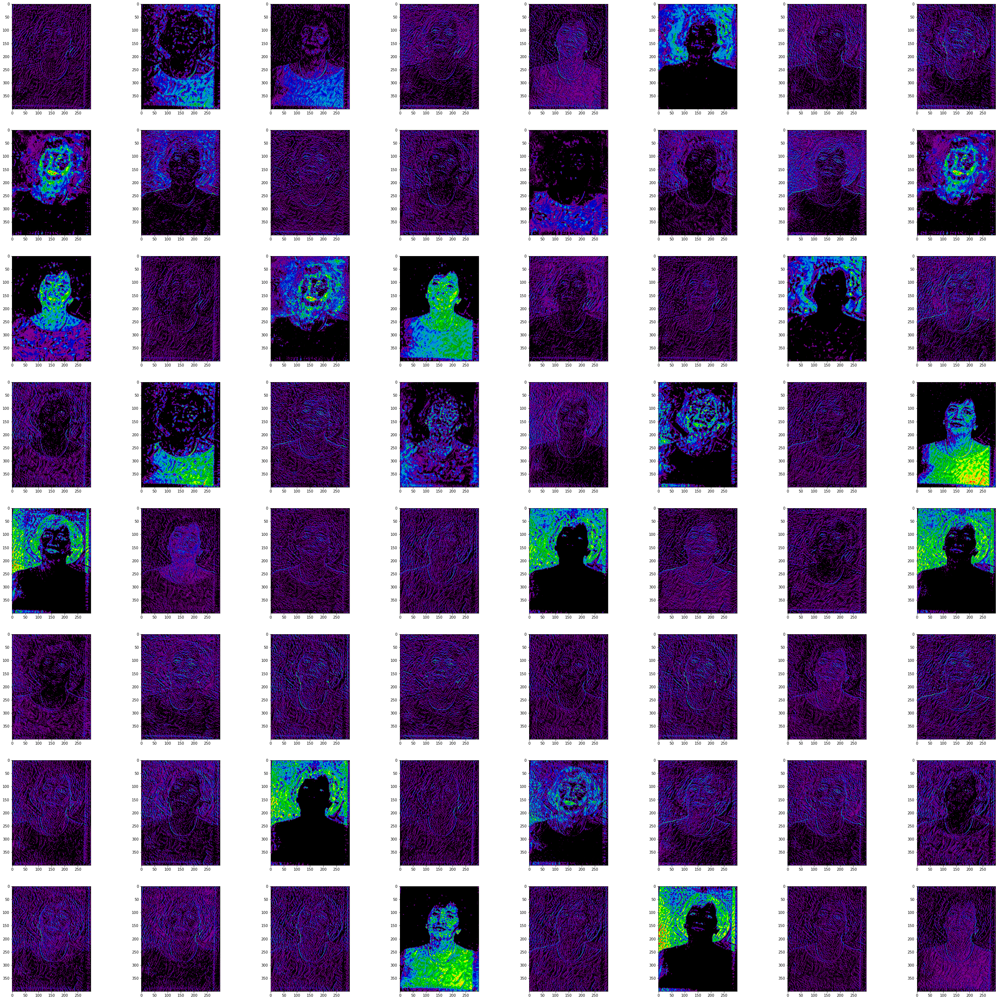

In [117]:
graficar_representaciones_intermedias(representaciones,0)

### Resultados

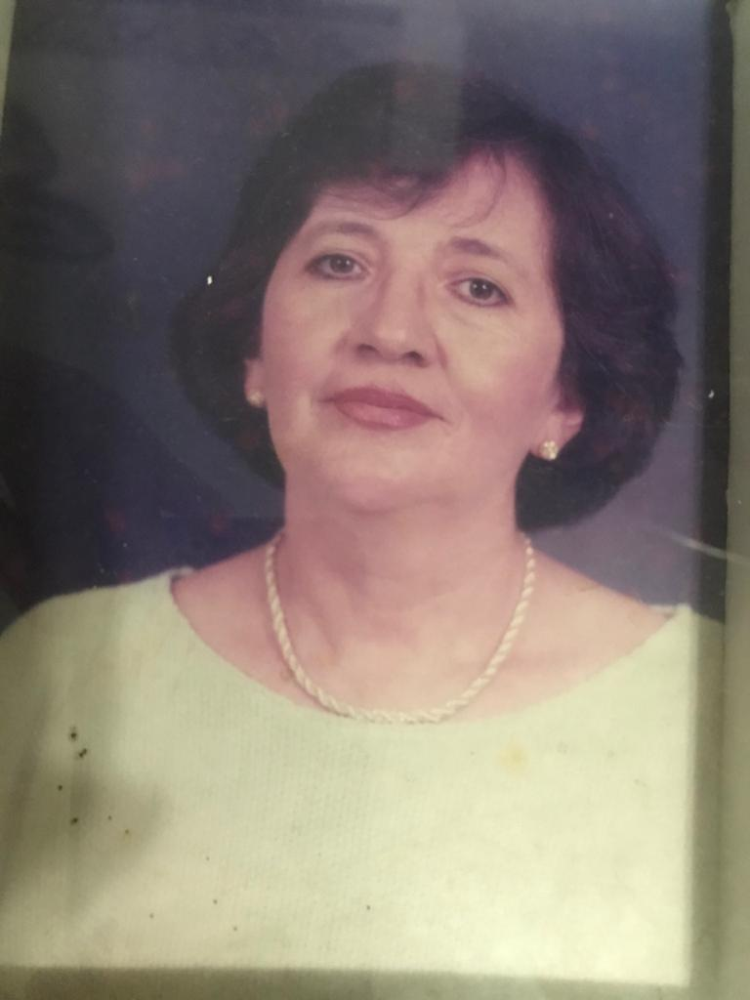

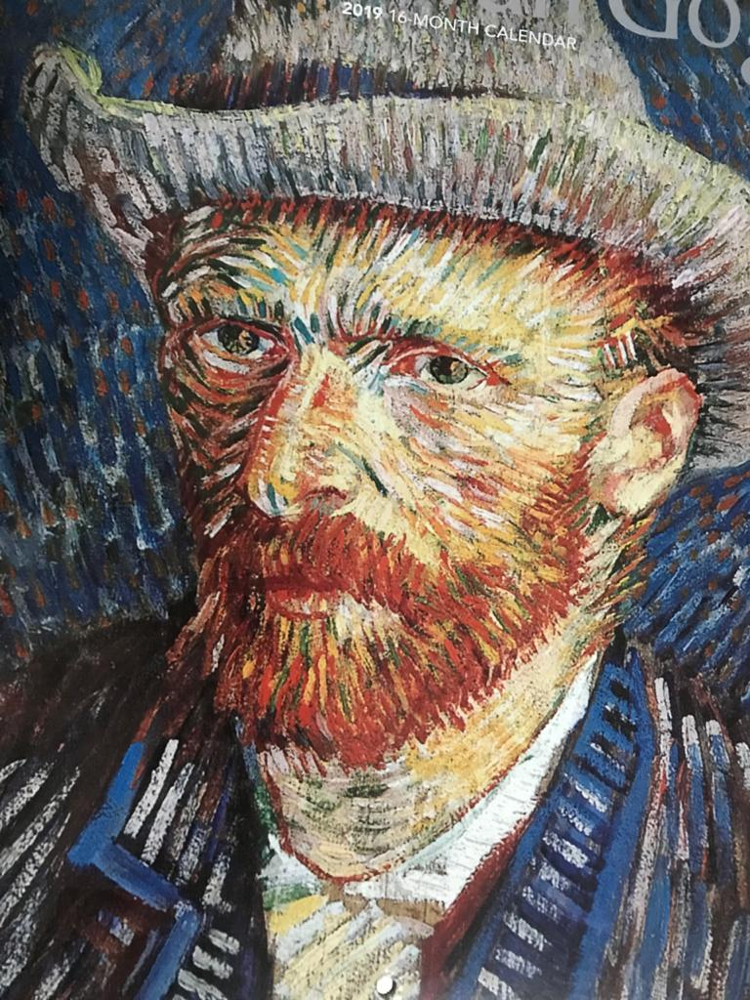

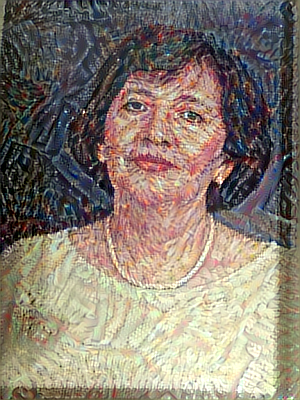

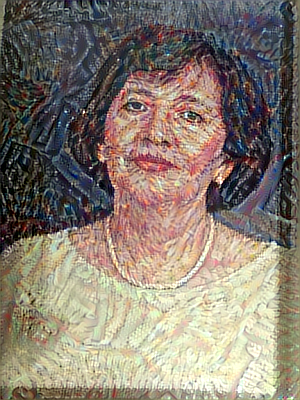

In [3]:
path_style_transfer1 = ".\\fuentes\\Mama.jpg"
path_style_transfer2 = ".\\fuentes\\VanGogh.jpg"
path_style_transfer3 = ".\\M+VanGogh\\Transferencia_Estilo_en_iteracion_3000.png"
path_style_transfer4 = ".\\M+VanGogh\\Transferencia_Estilo_en_iteracion_4000.png"
display(Image(path_style_transfer1,width = 400, height = 200))
display(Image(path_style_transfer2,width = 400, height = 200))
display(Image(path_style_transfer3,width = 400, height = 200))
display(Image(path_style_transfer4,width = 400, height = 200))

# Otro Ejemplo de Transferencia de Estilo

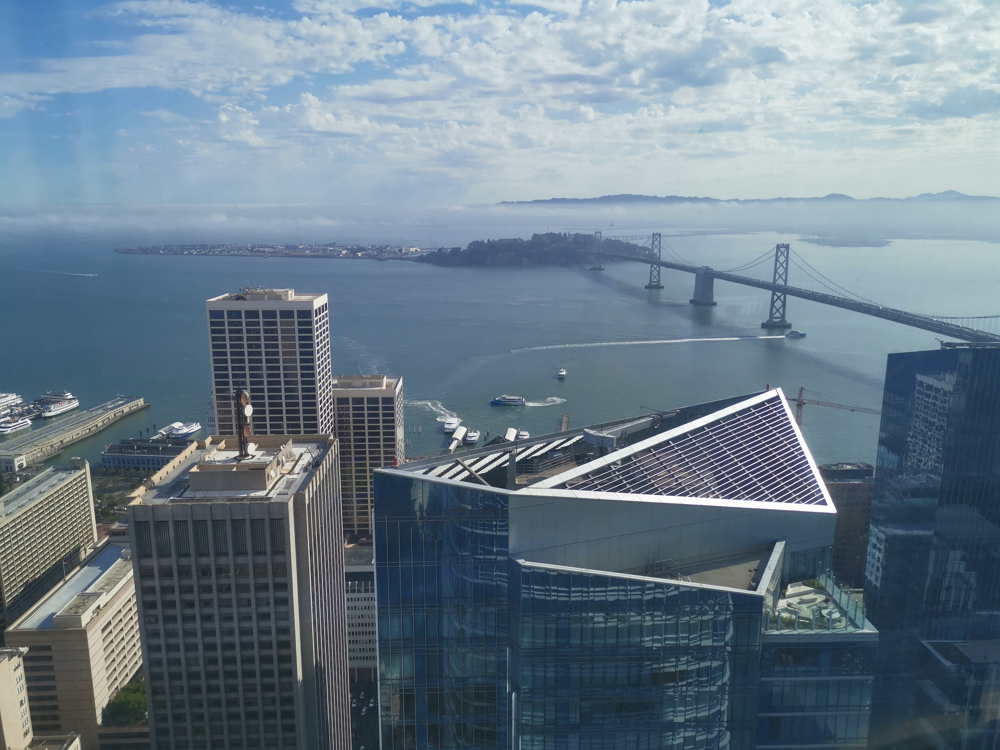

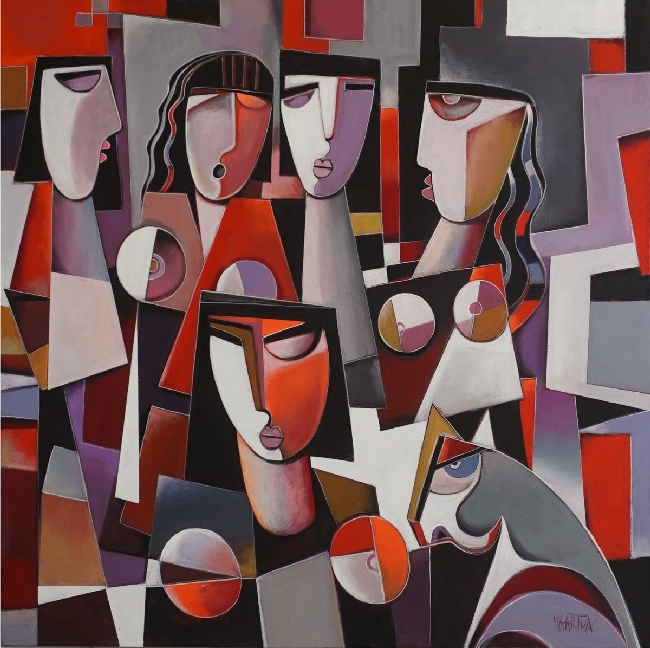

In [52]:
path_imagen_contenido = ".\\fuentes\\SF.jpg"
path_imagen_estilo = ".\\fuentes\\cubism2.jpg"
display(Image(path_imagen_contenido,width = 600, height = 300))
display(Image(path_imagen_estilo,width = 600, height = 300))

### TensorBoard

<img src="./imagenes/costoSF.png">

In [49]:
representaciones_SF = representaciones

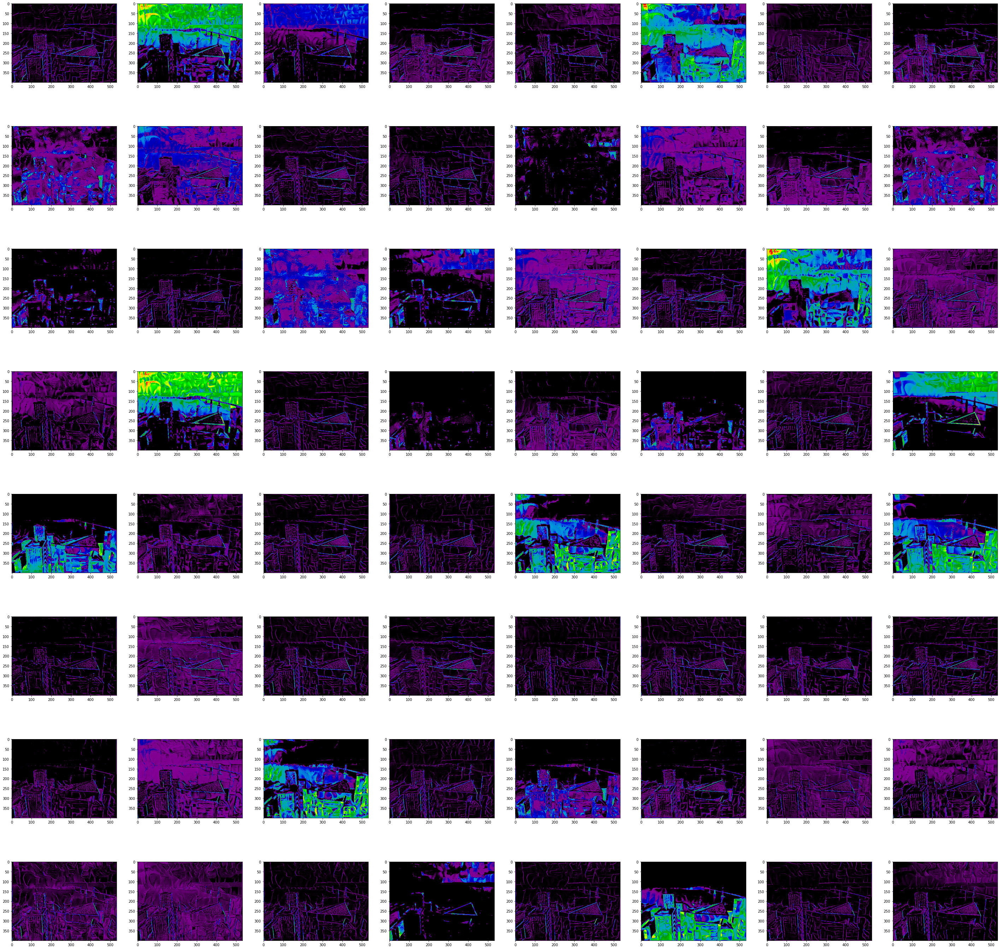

In [50]:
graficar_representaciones_intermedias(representaciones_SF,0)

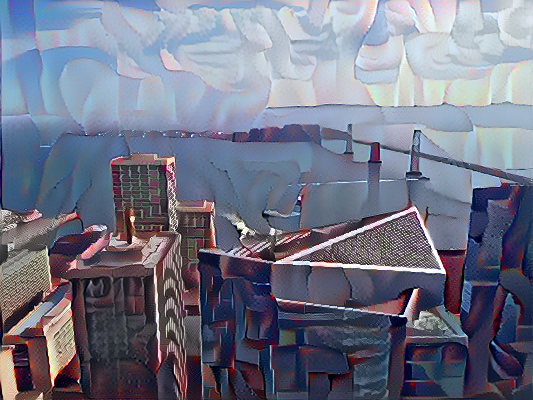

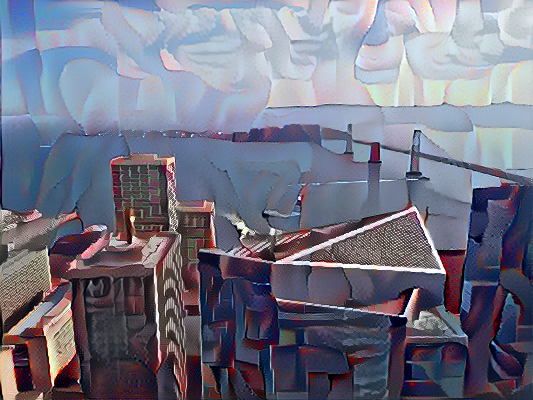

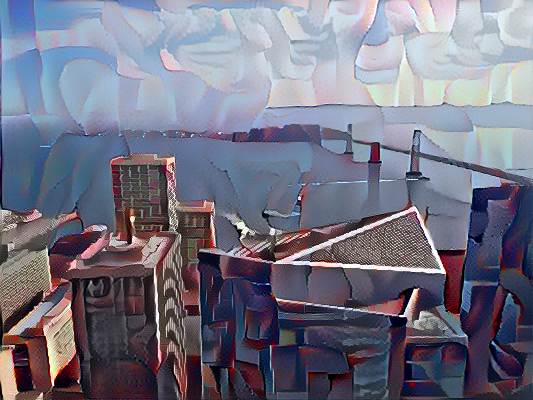

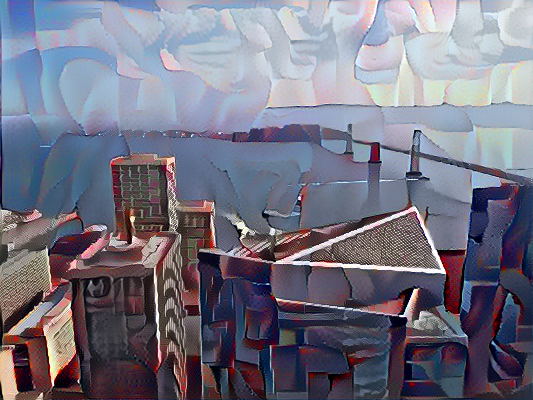

In [54]:
path_style_transfer1 = ".\\SF+Cubism\\Transferencia_Estilo_en_iteracion_1000.png"
path_style_transfer2 = ".\\SF+Cubism\\Transferencia_Estilo_en_iteracion_2000.png"
path_style_transfer3 = ".\\SF+Cubism\\Transferencia_Estilo_en_iteracion_3000.png"
path_style_transfer4 = ".\\SF+Cubism\\Transferencia_Estilo_en_iteracion_4000.png"
display(Image(path_style_transfer1,width = 600, height = 300))
display(Image(path_style_transfer2,width = 600, height = 300))
display(Image(path_style_transfer3,width = 600, height = 300))
display(Image(path_style_transfer4,width = 600, height = 300))

### Conclusiones:
- Se pudieron visualizar las representaciones intermedias generadas por los filtros convolucionales de las capas intermedias. Estas representaciones cambian con el avance del entrenamiento.
- Los valores de peso para la ponderación del estilo y el contenido son bastante críticos para el resultado final. En general, para obtener buenos resultados ambos pesos tuvieron que ajustarse con una diferencia de escala de 100 entre cada uno (10e-6 para el peso del estilo y 10e-8  para el peso el contenido). Esto depende mucho de las imágenes utilizadas, pero en general este orden de diferencia fue el que mostró los resultados más notorios de transferencia en la imagen de salida.
